<a href="https://colab.research.google.com/github/premkumar25/House-Price-prediction/blob/main/House_price.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Import Libraries..

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

In [2]:
df = pd.read_csv('dfBDS.csv',index_col='id')
df.head()

,month,project,investor,square,bedrooms,bathrooms,direction,balcony,district,ward,law_doc,price
id,,,,,,,,,,,,
28086120.0,12.0,Vinhomes Smart City Đại Mỗ,Tập đoàn Vingroup,60.0,3.0,1.0,Đông-Nam,Tây-Bắc,nam tu liem,dai mo,hồng,1560.0
28088954.0,12.0,Goldmark City,Công ty TNHH Thương mại - Quảng cáo - Xây dựng...,121.0,3.0,2.0,NaN,NaN,bac tu liem,phu dien,NaN,3300.0
28006876.0,12.0,Vinhomes Skylake,Tập đoàn Vingroup,104.0,3.0,2.0,Tây-Bắc,Đông-Nam,nam tu liem,my dinh 1,hồng,5600.0
28074753.0,12.0,Berriver Long Biên,Công ty CP Đầu tư Xây dựng số 9 Hà Nội,48.0,1.0,NaN,NaN,NaN,long bien,bo de,NaN,1440.0
12107414.0,12.0,IA20 Ciputra,Công ty CP Đầu tư Bất động sản Đông Đô - BQP,92.0,3.0,2.0,Tây-Bắc,Đông-Nam,bac tu liem,dong ngac,hồng,Thỏa thuận


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 130125 entries, 28086120.0 to 25608756.0
Data columns (total 12 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   month      130068 non-null  float64
 1   project    124867 non-null  object 
 2   investor   104435 non-null  object 
 3   square     126439 non-null  float64
 4   bedrooms   122212 non-null  float64
 5   bathrooms  96757 non-null   float64
 6   direction  66495 non-null   object 
 7   balcony    72169 non-null   object 
 8   district   130065 non-null  object 
 9   ward       127139 non-null  object 
 10  law_doc    48209 non-null   object 
 11  price      129502 non-null  object 
dtypes: float64(4), object(8)
memory usage: 12.9+ MB


<h4>Drop fields which has more number of missing values</h4>

In [4]:
df = df.drop(['balcony','direction'],axis=1)

In [5]:
df.head()

,month,project,investor,square,bedrooms,bathrooms,district,ward,law_doc,price
id,,,,,,,,,,
28086120.0,12.0,Vinhomes Smart City Đại Mỗ,Tập đoàn Vingroup,60.0,3.0,1.0,nam tu liem,dai mo,hồng,1560.0
28088954.0,12.0,Goldmark City,Công ty TNHH Thương mại - Quảng cáo - Xây dựng...,121.0,3.0,2.0,bac tu liem,phu dien,NaN,3300.0
28006876.0,12.0,Vinhomes Skylake,Tập đoàn Vingroup,104.0,3.0,2.0,nam tu liem,my dinh 1,hồng,5600.0
28074753.0,12.0,Berriver Long Biên,Công ty CP Đầu tư Xây dựng số 9 Hà Nội,48.0,1.0,NaN,long bien,bo de,NaN,1440.0
12107414.0,12.0,IA20 Ciputra,Công ty CP Đầu tư Bất động sản Đông Đô - BQP,92.0,3.0,2.0,bac tu liem,dong ngac,hồng,Thỏa thuận


<h3>Get the columns which has missing values and number of mising values and column type</h3>

In [10]:
for i in df.columns:
  if (df[i].isnull().sum()):
    print(i,df[i].isnull().sum(),df[i].dtype)

price 15746 float64


In [7]:
df = df.drop(['law_doc'],axis=1)

In [8]:
 df["price"] = df.price.apply(pd.to_numeric, errors='coerce')

<h3>Fill the missing values with mean and mode</h3>

In [12]:
df = df.dropna()

In [13]:
len(df)

114379

In [53]:
print(df['month'].mode()[0])
df['project'].mode()[0]
df['square'].mean()

10.0


88.76693899825212

In [9]:
df['month'].fillna(df['month'].mode()[0],inplace=True)
df['project'].fillna(df['project'].mode()[0],inplace=True)
df['investor'].fillna(df['investor'].mode()[0],inplace=True)
df['square'].fillna(df['square'].mean(),inplace=True)
df['bedrooms'].fillna(df['bedrooms'].mode()[0],inplace=True)
df['bathrooms'].fillna(df['bathrooms'].mode()[0],inplace=True)
df['district'].fillna(df['district'].mode()[0],inplace=True)
df['ward'].fillna(df['ward'].mode()[0],inplace=True)

<h3>Plot a Heatmap to find if there are any missing values in the data frame</h3>

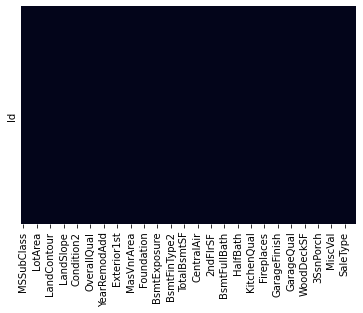

In [8]:
sns.heatmap(df.isnull(),yticklabels=False,cbar=False)

In [87]:
df.shape

(114379, 9)

<h1>Add test dataframe csv</h1>
<h3>Do the above exploratory data analysis for test dataframe simultaneoulsy and import the final csv of test data frame</h3>

In [9]:
test_df = pd.read_csv('test_df.csv')
test_df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,1461,20,RH,80.0,11622,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Feedr,Norm,1Fam,1Story,5,6,1961,1961,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,468.0,LwQ,144.0,270.0,882.0,GasA,TA,Y,SBrkr,896,0,0,896,0.0,0.0,1,0,2,1,TA,5,Typ,0,Attchd,1961.0,Unf,1.0,730.0,TA,TA,Y,140,0,0,0,120,0,0,6,2010,WD,Normal
1,1462,20,RL,81.0,14267,Pave,IR1,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,6,1958,1958,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,108.0,TA,TA,CBlock,TA,TA,No,ALQ,923.0,Unf,0.0,406.0,1329.0,GasA,TA,Y,SBrkr,1329,0,0,1329,0.0,0.0,1,1,3,1,Gd,6,Typ,0,Attchd,1958.0,Unf,1.0,312.0,TA,TA,Y,393,36,0,0,0,0,12500,6,2010,WD,Normal
2,1463,60,RL,74.0,13830,Pave,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,5,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,GLQ,791.0,Unf,0.0,137.0,928.0,GasA,Gd,Y,SBrkr,928,701,0,1629,0.0,0.0,2,1,3,1,TA,6,Typ,1,Attchd,1997.0,Fin,2.0,482.0,TA,TA,Y,212,34,0,0,0,0,0,3,2010,WD,Normal
3,1464,60,RL,78.0,9978,Pave,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,6,1998,1998,Gable,CompShg,VinylSd,VinylSd,BrkFace,20.0,TA,TA,PConc,TA,TA,No,GLQ,602.0,Unf,0.0,324.0,926.0,GasA,Ex,Y,SBrkr,926,678,0,1604,0.0,0.0,2,1,3,1,Gd,7,Typ,1,Attchd,1998.0,Fin,2.0,470.0,TA,TA,Y,360,36,0,0,0,0,0,6,2010,WD,Normal
4,1465,120,RL,43.0,5005,Pave,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,None,0.0,Gd,TA,PConc,Gd,TA,No,ALQ,263.0,Unf,0.0,1017.0,1280.0,GasA,Ex,Y,SBrkr,1280,0,0,1280,0.0,0.0,2,0,2,1,Gd,5,Typ,0,Attchd,1992.0,RFn,2.0,506.0,TA,TA,Y,0,82,0,0,144,0,0,1,2010,WD,Normal


In [14]:
column_list = []
for col in df.columns:
  if df[col].dtype=='O':
    column_list.append(col)
len(column_list)
column_list

['project', 'investor', 'district', 'ward']

<h3>Convert the categorical values to one hot encoding</h3>

In [15]:
def convert_cat_to_dummy(cols):
  df_final = final_df
  i = 0
  for l in cols:
    print(l)
    df1 = pd.get_dummies(final_df[l],drop_first=True)
    final_df.drop([l],axis=1,inplace=True)
    if i == 0:
      df_final=df1.copy()
    else:
      df_final = pd.concat([df_final,df1],axis=1)
    i+=1
  df_final = pd.concat([final_df,df_final],axis=1)
  return df_final


In [16]:
main_df = df.copy()

<h2>Concatenate the train dataframe and test dataframe before calling the one hot encoding function</h2>

This is done because few features of train and test data set does not match

In [18]:
final_df = df
final_df.shape

(114379, 9)

In [19]:
final_df = convert_cat_to_dummy(column_list)

project
investor
district
ward


In [20]:
final_df.shape

(114379, 1131)

<h2>Remove the duplicate columns</h2>

In [14]:
final_df = final_df.loc[:,~final_df.columns.duplicated()]

In [21]:
final_df.shape

(114379, 1131)

In [22]:
main_df.shape

(114379, 9)

<h2>Seperate the train and test data frame</h2> 

In [23]:
df_train = final_df.iloc[:90000,:]
df_test = final_df.iloc[90000:,:]

In [24]:
df_test.shape

(24379, 1131)

In [98]:
df_test.head()
df_test.shape

(114379, 1131)

<h2>Seperate the sale price value from train dataframe</h2>

In [101]:

x = df_train.drop(['price'],axis = 1)
y = df_train['price']

In [102]:
df_test.drop(['price'],axis=1,inplace=True)     #Remove the SalePrice column from test dataframe as we need to predict that and now it will be NAN values 

<h1>Use regression method to create model</h1>


In [105]:
import xgboost
classifer = xgboost.XGBRegressor()
classifer.fit(x,y)

ValueError: feature_names must be unique

In [ ]:
y_pred = classifer.predict(df_test)

In [ ]:
y_pred

array([124454.31, 156617.06, 180028.75, ..., 168865.73, 121561.18,
       237769.38], dtype=float32)

<h1>Export the prediction to csv</h1>

In [ ]:
output_pred = pd.DataFrame(y_pred)
sub = pd.read_csv('sample_submission.csv')
dataset = pd.concat([sub['Id'],output_pred],axis=1)
dataset.columns=['Id','SalePrice']
dataset.to_csv('sample_submission.csv',index=False)

The below method is used to find the accuracy of the model

In [ ]:
y_train_pred = classifer.predict(x)
from sklearn.metrics import r2_score
r2_score(y, y_train_pred)

0.9629767161427746

<h2>Hyperparameter optimization for better accuracy</h2>

In [20]:
regressor=xgboost.XGBRegressor()

In [21]:
param = {'max_depth': [2,3,5,10,15], 
         'n_estimators':[100, 150,200,500,900,1200,1500], 
          'booster':['gbtree','gblinear'],
          'learning_rate':[0.05,0.1,0.15,0.20],
         'min_child_weight':[1,2,3,4],
         'base_score':[0.25,0.5,0.75,1]}

In [23]:
from sklearn.model_selection import RandomizedSearchCV

In [25]:
random_cv = RandomizedSearchCV(estimator=regressor,
                               param_distributions=param,
                               cv=5,n_iter=50,
                               scoring='neg_mean_absolute_error',n_jobs=4,
                               verbose=5,
                               return_train_score=True,
                               random_state=42)

In [26]:
random_cv.fit(x,y)

Fitting 5 folds for each of 50 candidates, totalling 250 fits


[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:   13.9s
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:  1.7min
[Parallel(n_jobs=4)]: Done 154 tasks      | elapsed:  6.7min
[Parallel(n_jobs=4)]: Done 250 out of 250 | elapsed: 10.6min finished


[06:28:33] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


RandomizedSearchCV(cv=5, error_score=nan,
                   estimator=XGBRegressor(base_score=0.5, booster='gbtree',
                                          colsample_bylevel=1,
                                          colsample_bynode=1,
                                          colsample_bytree=1, gamma=0,
                                          importance_type='gain',
                                          learning_rate=0.1, max_delta_step=0,
                                          max_depth=3, min_child_weight=1,
                                          missing=None, n_estimators=100,
                                          n_jobs=1, nthread=None,
                                          objective='reg:linear',
                                          random_state=0, reg_alpha=...
                   iid='deprecated', n_iter=50, n_jobs=4,
                   param_distributions={'base_score': [0.25, 0.5, 0.75, 1],
                                        'booster': ['g

In [27]:
random_cv.best_estimator_

XGBRegressor(base_score=0.75, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=2, missing=None, n_estimators=1200,
             n_jobs=1, nthread=None, objective='reg:linear', random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
             silent=None, subsample=1, verbosity=1)

In [28]:
regressor=xgboost.XGBRegressor(base_score=0.75, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=2, missing=None, n_estimators=1200,
             n_jobs=1, nthread=None, objective='reg:linear', random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
             silent=None, subsample=1, verbosity=1)

In [29]:
regressor.fit(x,y)

[06:31:35] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor(base_score=0.75, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=2, missing=None, n_estimators=1200,
             n_jobs=1, nthread=None, objective='reg:linear', random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
             silent=None, subsample=1, verbosity=1)

In [30]:
y_prediction = regressor.predict(df_test)
y_prediction

array([124518.55, 157007.3 , 192706.56, ..., 159457.84, 110291.33,
       229746.1 ], dtype=float32)

Accuracy is increased after hyperparameter optimization

In [31]:
acc_pred = regressor.predict(x)
from sklearn.metrics import r2_score
r2_score(y, acc_pred)

0.9979866460598975

In [32]:
output_pred = pd.DataFrame(y_prediction)
sub = pd.read_csv('sample_submission.csv')
dataset = pd.concat([sub['Id'],output_pred],axis=1)
dataset.columns=['Id','SalePrice']
dataset.to_csv('sample_submission.csv',index=False)